In [5]:
# Import libraries and dependencies

import pandas as pd
import numpy as np
import pyarrow.feather as feather

from sklearn.preprocessing import StandardScaler
from sklearn.cluster import DBSCAN
from sklearn.metrics import silhouette_score

import plotly.express as px
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.animation import FuncAnimation, writers


In [6]:
# Load joint id's CSV

joint_ids_df = pd.read_csv("./joint_ids.csv")

# Load apache arrow files

#Completed
#sched_id429650_pitcher669302 = feather.read_feather("./Resources/sched_id429650_pitcher669302")
sched_id429650_pitcher680689 = feather.read_feather("./Resources/sched_id429650_pitcher680689")
sched_id429722_pitcher554430 = feather.read_feather("./Resources/sched_id429722_pitcher554430")
sched_id429722_pitcher642547 = feather.read_feather("./Resources/sched_id429722_pitcher642547")
sched_id429804_pitcher554430 = feather.read_feather("./Resources/sched_id429804_pitcher554430")
sched_id429804_pitcher641712 = feather.read_feather("./Resources/sched_id429804_pitcher641712")
sched_id430322_pitcher543243 = feather.read_feather("./Resources/sched_id430322_pitcher543243")
#Completed
#sched_id429650_pitcher669302 = feather.read_feather("./Resources/sched_id430322_pitcher669302")

In [7]:
# Data typing/info and import review

display(joint_ids_df.info())
display(joint_ids_df.head())
display(sched_id429650_pitcher680689.info())
display(sched_id429650_pitcher680689.head())
display(sched_id429650_pitcher680689.tail())


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 29 entries, 0 to 28
Data columns (total 3 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   joint_type_id  29 non-null     int64 
 1   joint_type     29 non-null     object
 2   hawkeye        29 non-null     object
dtypes: int64(1), object(2)
memory usage: 828.0+ bytes


None

,joint_type_id,joint_type,hawkeye
0,1,left ankle,lAnkle
1,2,left ear,lEar
2,3,left elbow,lElbow
3,4,left eye,lEye
4,5,left hip,lHip


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1368160 entries, 0 to 1368159
Data columns (total 10 columns):
 #   Column           Non-Null Count    Dtype  
---  ------           --------------    -----  
 0   sched_id         1368160 non-null  int32  
 1   joint_type_id    1368160 non-null  uint8  
 2   time             1368160 non-null  float64
 3   x                1368160 non-null  float32
 4   y                1368160 non-null  float32
 5   z                1368160 non-null  float32
 6   astros_pitch_id  1368160 non-null  int64  
 7   pitcher_id       1368160 non-null  int64  
 8   bats             1368160 non-null  object 
 9   throws           1368160 non-null  object 
dtypes: float32(3), float64(1), int32(1), int64(2), object(2), uint8(1)
memory usage: 74.4+ MB


None

,sched_id,joint_type_id,time,x,y,z,astros_pitch_id,pitcher_id,bats,throws
0,429650,1,-2.013,0.2787,59.749401,1.2872,1,680689,L,R
1,429650,1,-2.009,0.2778,59.749199,1.2872,1,680689,L,R
2,429650,1,-2.006,0.2764,59.750000,1.2870,1,680689,L,R
3,429650,1,-2.003,0.2750,59.750401,1.2882,1,680689,L,R
4,429650,1,-1.999,0.2733,59.749199,1.2898,1,680689,L,R


,sched_id,joint_type_id,time,x,y,z,astros_pitch_id,pitcher_id,bats,throws
1368155,429650,18,0.975,3.3575,56.207401,3.5152,162,680689,R,R
1368156,429650,18,0.978,3.3623,56.262901,3.4914,162,680689,R,R
1368157,429650,18,0.981,3.3691,56.328400,3.4750,162,680689,R,R
1368158,429650,18,0.985,3.3770,56.389801,3.4570,162,680689,R,R
1368159,429650,18,0.988,3.3817,56.448399,3.4391,162,680689,R,R


In [8]:
merged_df = pd.merge(sched_id429650_pitcher680689, joint_ids_df, on='joint_type_id', how='left')
merged_df.dropna(inplace=True)
display(merged_df.info())
display(merged_df.head())
display(merged_df.tail())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1368160 entries, 0 to 1368159
Data columns (total 12 columns):
 #   Column           Non-Null Count    Dtype  
---  ------           --------------    -----  
 0   sched_id         1368160 non-null  int32  
 1   joint_type_id    1368160 non-null  uint8  
 2   time             1368160 non-null  float64
 3   x                1368160 non-null  float32
 4   y                1368160 non-null  float32
 5   z                1368160 non-null  float32
 6   astros_pitch_id  1368160 non-null  int64  
 7   pitcher_id       1368160 non-null  int64  
 8   bats             1368160 non-null  object 
 9   throws           1368160 non-null  object 
 10  joint_type       1368160 non-null  object 
 11  hawkeye          1368160 non-null  object 
dtypes: float32(3), float64(1), int32(1), int64(2), object(4), uint8(1)
memory usage: 95.2+ MB


None

,sched_id,joint_type_id,time,x,y,z,astros_pitch_id,pitcher_id,bats,throws,joint_type,hawkeye
0,429650,1,-2.013,0.2787,59.749401,1.2872,1,680689,L,R,left ankle,lAnkle
1,429650,1,-2.009,0.2778,59.749199,1.2872,1,680689,L,R,left ankle,lAnkle
2,429650,1,-2.006,0.2764,59.750000,1.2870,1,680689,L,R,left ankle,lAnkle
3,429650,1,-2.003,0.2750,59.750401,1.2882,1,680689,L,R,left ankle,lAnkle
4,429650,1,-1.999,0.2733,59.749199,1.2898,1,680689,L,R,left ankle,lAnkle


,sched_id,joint_type_id,time,x,y,z,astros_pitch_id,pitcher_id,bats,throws,joint_type,hawkeye
1368155,429650,18,0.975,3.3575,56.207401,3.5152,162,680689,R,R,right wrist,rWrist
1368156,429650,18,0.978,3.3623,56.262901,3.4914,162,680689,R,R,right wrist,rWrist
1368157,429650,18,0.981,3.3691,56.328400,3.4750,162,680689,R,R,right wrist,rWrist
1368158,429650,18,0.985,3.3770,56.389801,3.4570,162,680689,R,R,right wrist,rWrist
1368159,429650,18,0.988,3.3817,56.448399,3.4391,162,680689,R,R,right wrist,rWrist


In [9]:
# ####################################################################
# # Attempt at using an animation library that i've never used before. 
# # Rendering took too long for more complex setups and image produced is in GIF format
# # not necessarily usable/friendly in this formatting.
# ####################################################################

# # Filter the data for joint_type_id 13, 17, and 18
# filtered_df = sched_id429650_pitcher669302_merged[sched_id429650_pitcher669302_merged['joint_type_id'].isin([13, 17, 18])]

# # Sort by time for consistent animation
# filtered_df = filtered_df.sort_values(by='time')

# # Create a 3D plot
# fig = plt.figure()
# ax = fig.add_subplot(111, projection='3d')

# # Create legend mapping
# joint_type_legend = {row['joint_type_id']: row['joint_type'] for _, row in sched_id429650_pitcher669302_merged.iterrows()}
# colors = {13:"r",17:"g",18:"b"}

# # Plot points for each joint type with corresponding color to create legend
# for joint_id, color in colors.items():
#     ax.scatter([],[],[],c=color, label=joint_type_legend[joint_id])

# # Initialize empty lines and points
# line1, = ax.plot([], [], [], 'k-')  # Line from 17 to 13
# line2, = ax.plot([], [], [], 'k-')  # Line from 13 to 18
# points, = ax.plot([], [], [], 'ro')  # Points for joints

# # Set plot limits (adjust as needed)
# ax.set_xlim([filtered_df['x'].min(), filtered_df['x'].max()])
# ax.set_ylim([filtered_df['y'].min(), filtered_df['y'].max()])
# ax.set_zlim([filtered_df['z'].min(), filtered_df['z'].max()])

# # Set labels
# ax.set_xlabel('X')
# ax.set_ylabel('Y')
# ax.set_zlabel('Z')

# # Animation update function
# def update(frame_num):
#     current_time = filtered_df['time'].unique()[frame_num]
#     current_data = filtered_df[filtered_df['time'] == current_time]
    
#     # Update points
#     points.set_data(current_data[['x', 'y']].values.T)
#     points.set_3d_properties(current_data['z'].values)
    
#     # Update lines
#     if 13 in current_data['joint_type_id'].values and 17 in current_data['joint_type_id'].values:
#         coords_13 = current_data[current_data['joint_type_id'] == 13][['x', 'y', 'z']].values[0]
#         coords_17 = current_data[current_data['joint_type_id'] == 17][['x', 'y', 'z']].values[0]
#         line1.set_data([coords_17[0], coords_13[0]], [coords_17[1], coords_13[1]])
#         line1.set_3d_properties([coords_17[2], coords_13[2]])
    
#     if 13 in current_data['joint_type_id'].values and 18 in current_data['joint_type_id'].values:
#         coords_13 = current_data[current_data['joint_type_id'] == 13][['x', 'y', 'z']].values[0]
#         coords_18 = current_data[current_data['joint_type_id'] == 18][['x', 'y', 'z']].values[0]
#         line2.set_data([coords_13[0], coords_18[0]], [coords_13[1], coords_18[1]])
#         line2.set_3d_properties([coords_13[2], coords_18[2]])

# # Create animation
# ani = FuncAnimation(fig, update, frames=len(filtered_df['time'].unique()), interval=100)

# # Check if ImageMagick is available
# if 'imagemagick' in writers.list():
#     # Save the animation
#     ani.save('animation.gif', writer='imagemagick')
# else:
#     print("ImageMagick not available")



In [10]:
# 3D over time Visualization function

# Joints for lefty or righty

joint_types_right = [13,15,17,18]
joint_types_left = [3,5,7,8]

def plot_joint_movements(df, joint_types):
    
    filtered_df = df[df["joint_type_id"].isin(joint_types)]

    print(filtered_df.shape)
    print(filtered_df)

    fig = px.scatter_3d(filtered_df, x='x', y='y', z='z',
                        animation_frame='time', color='joint_type',
                        size_max=3)

    fig.update_layout(title='3D Movement of Specified Joints Over Time')
    
    return fig

In [11]:
# Test whether pitcher is lefy or righty
# and assign to joint_types

if (merged_df["throws"].iloc[0]) == "R":
    joint_types = joint_types_right
else:
    joint_types = joint_types_left

# Plot 3D positioning over time of assigned joints
# see legend on plot

plot = plot_joint_movements(merged_df, joint_types=joint_types)

plot.show()

plot.write_html("./images_and_output_data/uncleaned_3d_plot.html")

(342040, 12)
         sched_id  joint_type_id   time       x          y       z  \
9000       429650             13 -2.013 -0.9770  60.251099  5.0803   
9001       429650             13 -2.009 -0.9749  60.257198  5.0751   
9002       429650             13 -2.006 -0.9736  60.260300  5.0723   
9003       429650             13 -2.003 -0.9729  60.266998  5.0674   
9004       429650             13 -1.999 -0.9720  60.274101  5.0659   
...           ...            ...    ...     ...        ...     ...   
1368155    429650             18  0.975  3.3575  56.207401  3.5152   
1368156    429650             18  0.978  3.3623  56.262901  3.4914   
1368157    429650             18  0.981  3.3691  56.328400  3.4750   
1368158    429650             18  0.985  3.3770  56.389801  3.4570   
1368159    429650             18  0.988  3.3817  56.448399  3.4391   

         astros_pitch_id  pitcher_id bats throws   joint_type hawkeye  
9000                   1      680689    L      R  right elbow  rElbow  
90

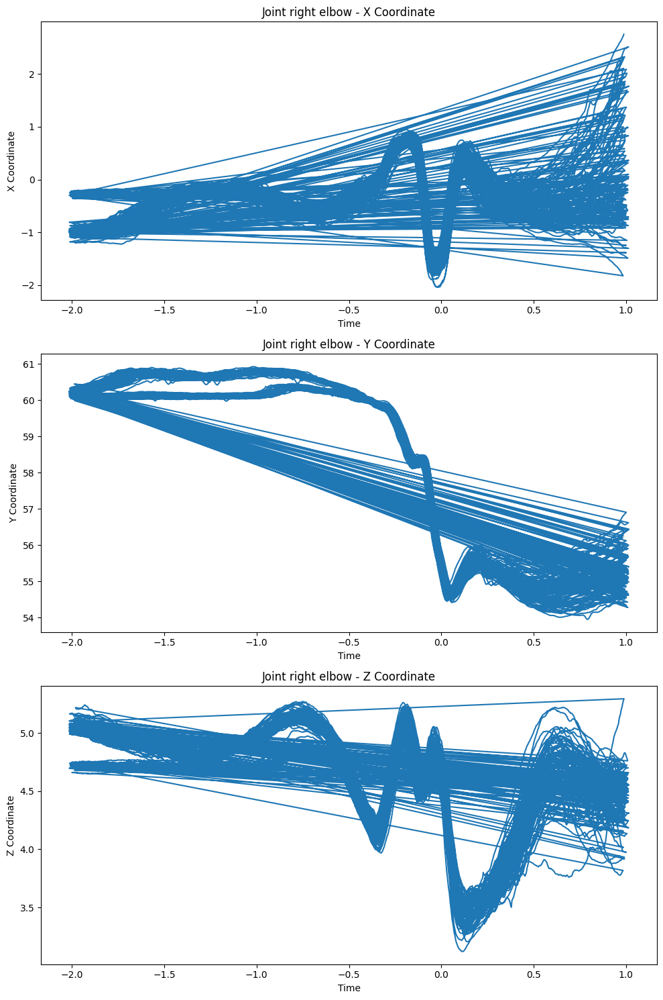

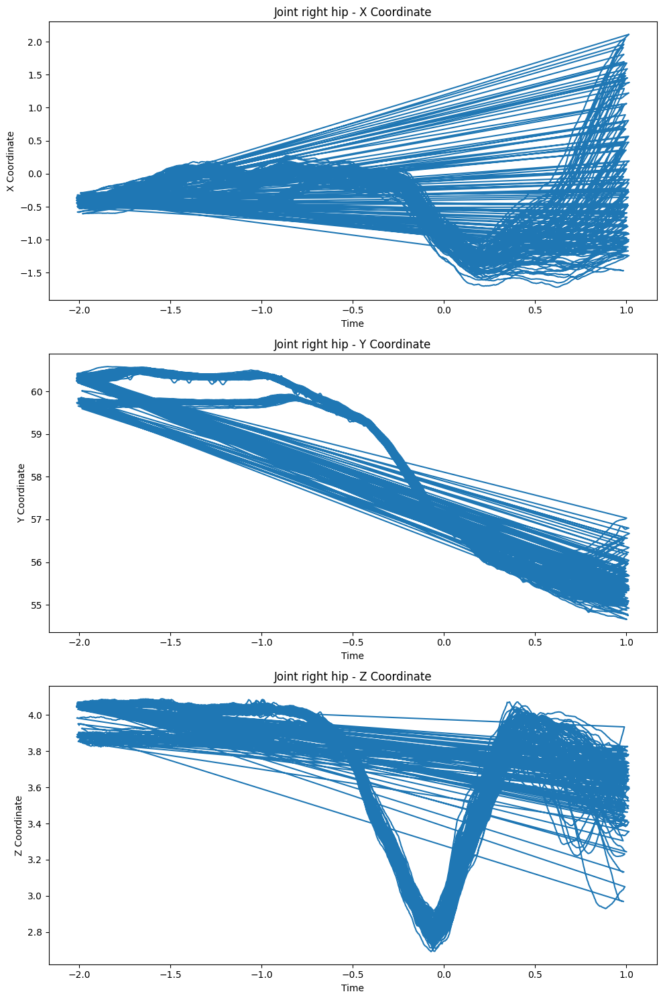

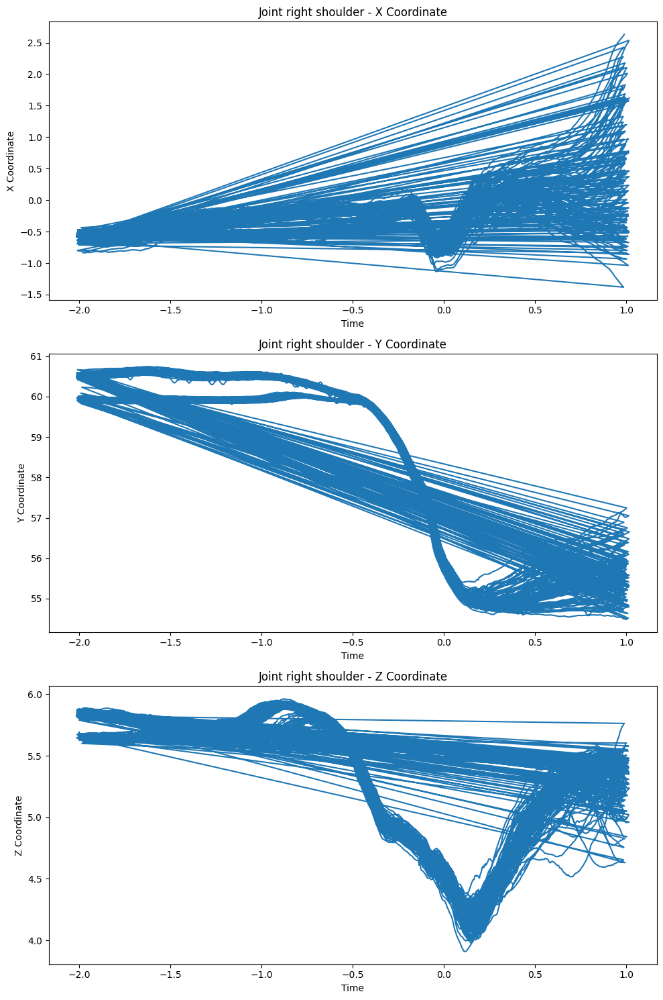

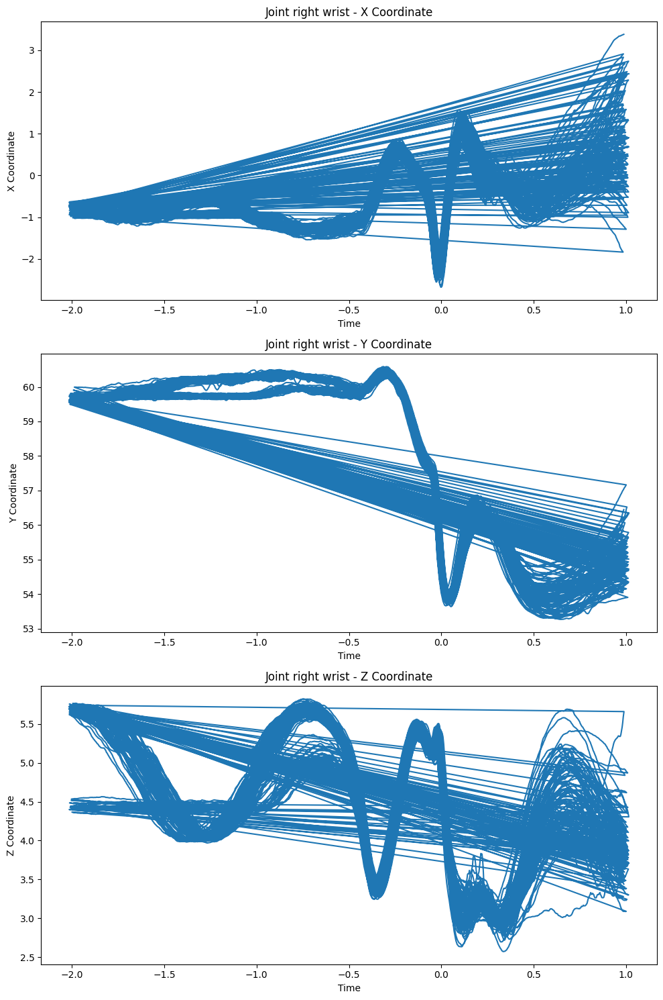

In [12]:
# 2D visualization of each joint of each axis over time

joint_ids_dict = dict(zip(joint_ids_df['joint_type_id'], joint_ids_df['joint_type']))

for joint_type_id in joint_types:
    subset = merged_df[merged_df['joint_type_id'] == joint_type_id]
    fig, axs = plt.subplots(3, 1, figsize=(10, 15))

    # Get the joint type for the current plot/joint_type_id

    joint_type = joint_ids_dict[joint_type_id]
    
    # Plot x, y, z coordinates for the current joint_type_id
    axs[0].plot(subset['time'], subset['x'])
    axs[0].set_title(f'Joint {joint_type} - X Coordinate')
    axs[0].set_xlabel('Time')
    axs[0].set_ylabel('X Coordinate')
    
    axs[1].plot(subset['time'], subset['y'])
    axs[1].set_title(f'Joint {joint_type} - Y Coordinate')
    axs[1].set_xlabel('Time')
    axs[1].set_ylabel('Y Coordinate')

    axs[2].plot(subset['time'], subset['z'])
    axs[2].set_title(f'Joint {joint_type} - Z Coordinate')
    axs[2].set_xlabel('Time')
    axs[2].set_ylabel('Z Coordinate')
    
    plt.tight_layout()
    plt.show()


In [13]:
# Apply DBSCAN to help identify raw data outliers for x,y,z to joint_types

# Identify joints to be scanned

filtered_df = merged_df[merged_df["joint_type_id"].isin(joint_types)]

def apply_dbscan(group,eps=1.25,min_samples=10):
    scaler = StandardScaler()
    X_scaled = np.stack([
        scaler.fit_transform(group[["x"]]).flatten(),
        scaler.fit_transform(group[["y"]]).flatten(),
        scaler.fit_transform(group[["z"]]).flatten()
    ],axis=-1)
    
    #X_scaled = scaler.fit_transform(group[["x","y","z"]])
    dbscan = DBSCAN(eps=eps, min_samples=min_samples)
    #group["dbscan_cluster"] = dbscan.fit_predict(X_scaled)
    group["dbscan_cluster"] = dbscan.fit_predict(X_scaled)
    return group

# Apply DBSCAN to each group of data
grouped = filtered_df.groupby(['joint_type_id',"time"])
dbscan_df = grouped.apply(apply_dbscan)

# Filter out outliers (noise points are labeled as -1)
cleaned_df = dbscan_df[dbscan_df['dbscan_cluster'] != -1]

/var/folders/sr/78cv2dx14kgdcwtf90634z580000gn/T/ipykernel_5019/1050584917.py:23: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



In [14]:
# Raw data processed review

display(merged_df.shape[0])
display(cleaned_df.shape[0])
display(cleaned_df["dbscan_cluster"].value_counts())
display(cleaned_df.info())
display(cleaned_df.head())
display(cleaned_df.tail())


1368160

204857

dbscan_cluster
0    203384
1      1473
Name: count, dtype: int64

<class 'pandas.core.frame.DataFrame'>
MultiIndex: 204857 entries, (13, -2.002, 23400) to (18, 0.993, 1137705)
Data columns (total 13 columns):
 #   Column           Non-Null Count   Dtype  
---  ------           --------------   -----  
 0   sched_id         204857 non-null  int32  
 1   joint_type_id    204857 non-null  uint8  
 2   time             204857 non-null  float64
 3   x                204857 non-null  float32
 4   y                204857 non-null  float32
 5   z                204857 non-null  float32
 6   astros_pitch_id  204857 non-null  int64  
 7   pitcher_id       204857 non-null  int64  
 8   bats             204857 non-null  object 
 9   throws           204857 non-null  object 
 10  joint_type       204857 non-null  object 
 11  hawkeye          204857 non-null  object 
 12  dbscan_cluster   204857 non-null  int64  
dtypes: float32(3), float64(1), int32(1), int64(3), object(4), uint8(1)
memory usage: 28.0+ MB


None

sched_id  joint_type_id   time       x  \
joint_type_id time                                                    
13            -2.002 23400     429650             13 -2.002 -1.0134   
                     52203     429650             13 -2.002 -1.0344   
                     239420    429650             13 -2.002 -0.9899   
                     253819    429650             13 -2.002 -0.9882   
                     354635    429650             13 -2.002 -1.0160   

                                     y       z  astros_pitch_id  pitcher_id  \
joint_type_id time                                                            
13            -2.002 23400   60.241001  5.0282                2      680689   
                     52203   60.169201  5.0611                4      680689   
                     239420  60.243599  5.1045               36      680689   
                     253819  60.323399  5.0248               37      680689   
                     354635  60.223499  5.0702               44      680689   

                            bats throws   joint_type hawkeye  dbscan_cluster  
joint_type_id time                                                            
13            -2.002 23400     R      R  right elbow  rElbow               0  
                     52203     R      R  right elbow  rElbow               0  
                     239420    R      R  right elbow  rElbow               0  
                     253819    R      R  right elbow  rElbow               0  
                     354635    R      R  right elbow  rElbow               0

sched_id  joint_type_id   time       x  \
joint_type_id time                                                    
18            0.993 864108     429650             18  0.993  0.0605   
                    892909     429650             18  0.993  0.7430   
                    979309     429650             18  0.993  0.1958   
                    1108908    429650             18  0.993 -0.1644   
                    1137705    429650             18  0.993  1.3378   

                                     y       z  astros_pitch_id  pitcher_id  \
joint_type_id time                                                            
18            0.993 864108   54.550598  3.6913              118      680689   
                    892909   55.020199  3.7675              120      680689   
                    979309   54.283600  3.7986              126      680689   
                    1108908  54.650501  3.8641              144      680689   
                    1137705  54.654900  3.9348              146      680689   

                            bats throws   joint_type hawkeye  dbscan_cluster  
joint_type_id time                                                            
18            0.993 864108     L      R  right wrist  rWrist               0  
                    892909     L      R  right wrist  rWrist               0  
                    979309     R      R  right wrist  rWrist               0  
                    1108908    L      R  right wrist  rWrist               0  
                    1137705    R      R  right wrist  rWrist               0

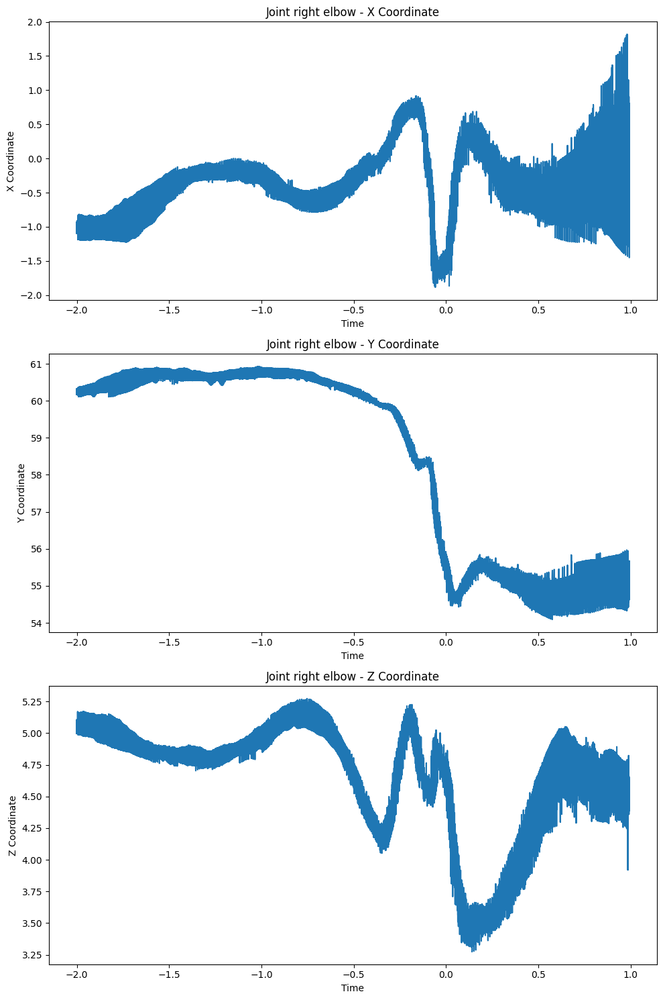

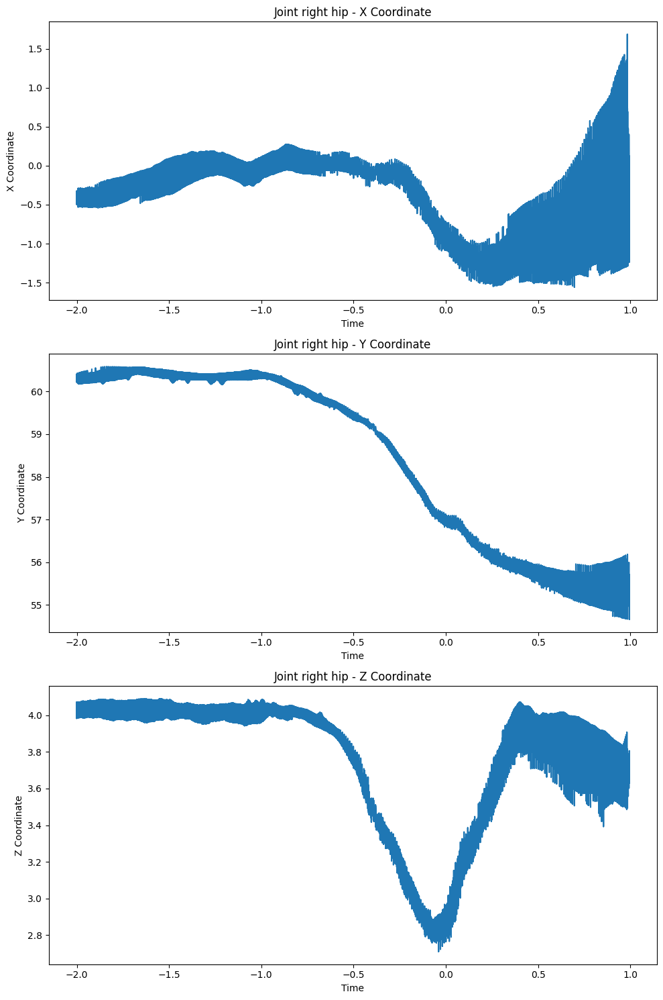

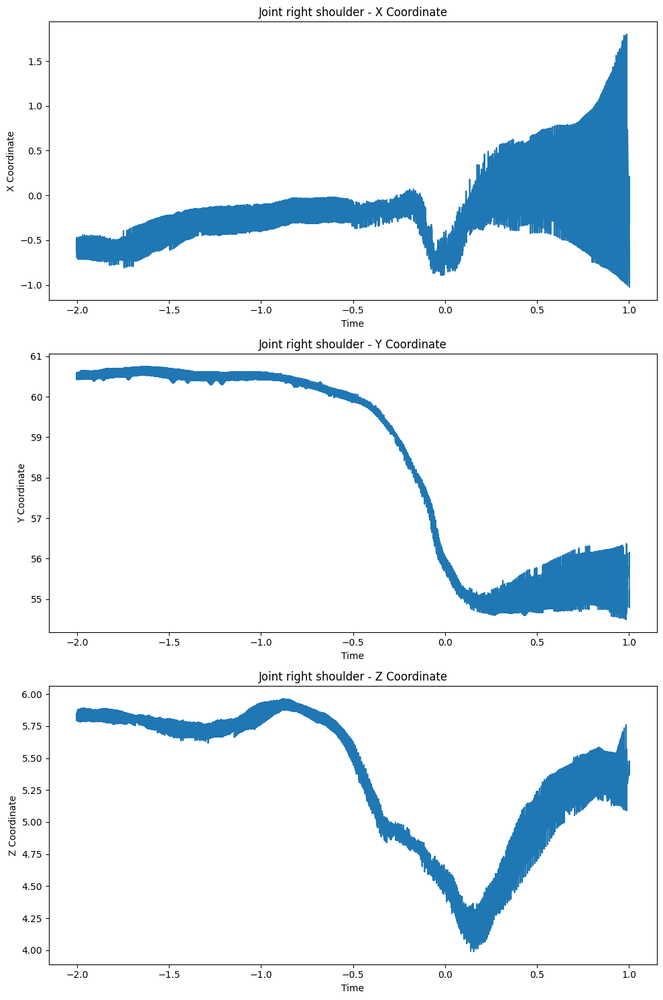

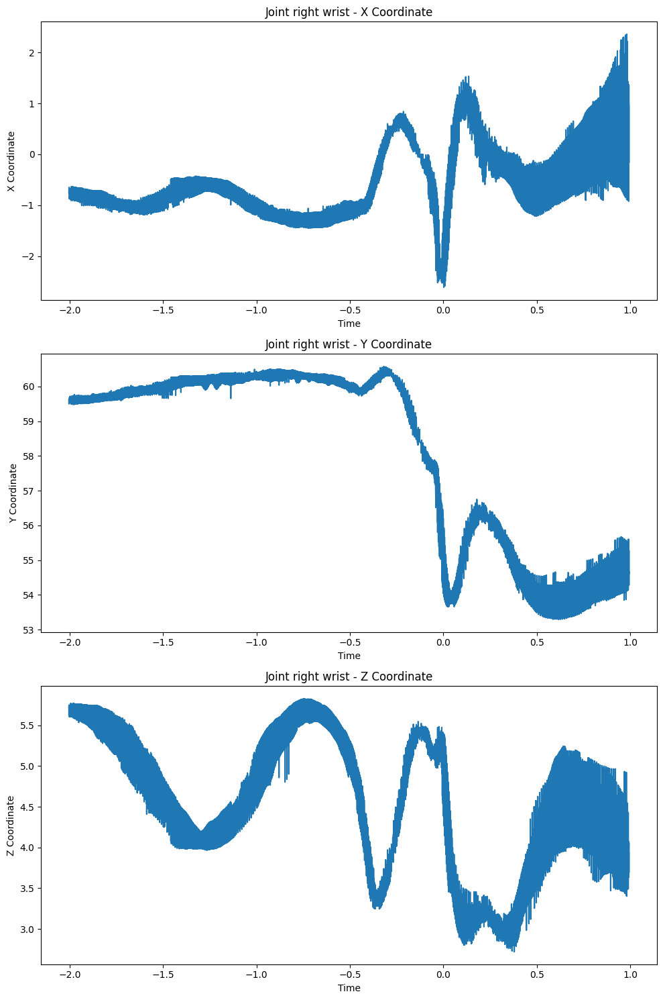

In [15]:
for joint_type_id in joint_types:
    subset = cleaned_df[cleaned_df['joint_type_id'] == joint_type_id]
    fig, axs = plt.subplots(3, 1, figsize=(10, 15))

    # Get the joint type for the current plot/joint_type_id

    joint_type = joint_ids_dict[joint_type_id]
    
    # Plot x, y, z coordinates for the current joint_type_id
    axs[0].plot(subset['time'], subset['x'])
    axs[0].set_title(f'Joint {joint_type} - X Coordinate')
    axs[0].set_xlabel('Time')
    axs[0].set_ylabel('X Coordinate')
    
    axs[1].plot(subset['time'], subset['y'])
    axs[1].set_title(f'Joint {joint_type} - Y Coordinate')
    axs[1].set_xlabel('Time')
    axs[1].set_ylabel('Y Coordinate')
    
    axs[2].plot(subset['time'], subset['z'])
    axs[2].set_title(f'Joint {joint_type} - Z Coordinate')
    axs[2].set_xlabel('Time')
    axs[2].set_ylabel('Z Coordinate')
    
    plt.tight_layout()
    plt.show()

In [16]:
cleaned_df = cleaned_df.reset_index(level=0, drop = True)
cleaned_df = cleaned_df.reset_index(level=0, drop = True)

display(cleaned_df.head())
print(cleaned_df.dtypes)

,sched_id,joint_type_id,time,x,y,z,astros_pitch_id,pitcher_id,bats,throws,joint_type,hawkeye,dbscan_cluster
23400,429650,13,-2.002,-1.0134,60.241001,5.0282,2,680689,R,R,right elbow,rElbow,0
52203,429650,13,-2.002,-1.0344,60.169201,5.0611,4,680689,R,R,right elbow,rElbow,0
239420,429650,13,-2.002,-0.9899,60.243599,5.1045,36,680689,R,R,right elbow,rElbow,0
253819,429650,13,-2.002,-0.9882,60.323399,5.0248,37,680689,R,R,right elbow,rElbow,0
354635,429650,13,-2.002,-1.0160,60.223499,5.0702,44,680689,R,R,right elbow,rElbow,0


sched_id             int32
joint_type_id        uint8
time               float64
x                  float32
y                  float32
z                  float32
astros_pitch_id      int64
pitcher_id           int64
bats                object
throws              object
joint_type          object
hawkeye             object
dbscan_cluster       int64
dtype: object


In [17]:
# Calculate differences and velocities

# Preprocess the DataFrame to average coordinates for duplicate time points within each joint_type_id
velo_df = cleaned_df.groupby(['joint_type_id', 'time']).agg({'x': 'mean', 'y': 'mean', 'z': 'mean'}).reset_index()

velo_df['x_diff'] = velo_df.groupby('joint_type_id')['x'].diff()
velo_df['y_diff'] = velo_df.groupby('joint_type_id')['y'].diff()
velo_df['z_diff'] = velo_df.groupby('joint_type_id')['z'].diff()
velo_df['time_diff'] = velo_df.groupby('joint_type_id')['time'].diff()

velo_df['x_velocity'] = velo_df['x_diff'] / velo_df['time_diff']
velo_df['y_velocity'] = velo_df['y_diff'] / velo_df['time_diff']
velo_df['z_velocity'] = velo_df['z_diff'] / velo_df['time_diff']

# Combine velocities into a single magnitude

velo_df["velocity"] = np.sqrt(velo_df['x_velocity']**2 + velo_df['y_velocity']**2 + velo_df['z_velocity']**2)

# Drop intermediate columns

# velo_df.drop(columns=['x_diff', 'y_diff', 'z_diff', 'time_diff'], inplace=True)

display(velo_df.head())
display(cleaned_df.head())

,joint_type_id,time,x,y,z,x_diff,y_diff,z_diff,time_diff,x_velocity,y_velocity,z_velocity,velocity
0,13,-2.002,-1.016877,60.240238,5.037923,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,13,-1.999,-1.010388,60.238678,5.041612,0.006489,-0.001560,0.003689,0.003,2.162894,-0.520070,1.229604,2.541753
2,13,-1.996,-1.010072,60.235725,5.053755,0.000316,-0.002953,0.012144,0.003,0.105341,-0.984192,4.047871,4.167132
3,13,-1.995,-1.000607,60.245022,5.046928,0.009465,0.009296,-0.006827,0.001,9.465098,9.296417,-6.826878,14.920379
4,13,-1.994,-0.954477,60.219360,5.043369,0.046130,-0.025661,-0.003560,0.001,46.130180,-25.661469,-3.559589,52.907232


,sched_id,joint_type_id,time,x,y,z,astros_pitch_id,pitcher_id,bats,throws,joint_type,hawkeye,dbscan_cluster
23400,429650,13,-2.002,-1.0134,60.241001,5.0282,2,680689,R,R,right elbow,rElbow,0
52203,429650,13,-2.002,-1.0344,60.169201,5.0611,4,680689,R,R,right elbow,rElbow,0
239420,429650,13,-2.002,-0.9899,60.243599,5.1045,36,680689,R,R,right elbow,rElbow,0
253819,429650,13,-2.002,-0.9882,60.323399,5.0248,37,680689,R,R,right elbow,rElbow,0
354635,429650,13,-2.002,-1.0160,60.223499,5.0702,44,680689,R,R,right elbow,rElbow,0


In [18]:
velo_df["curvature"] = np.nan

for i in range(1, len(velo_df) - 1):
    if velo_df.iloc[i]['joint_type_id'] == velo_df.iloc[i - 1]['joint_type_id'] == velo_df.iloc[i + 1]['joint_type_id']:
        a = velo_df.iloc[i + 1][['x_diff', 'y_diff', 'z_diff']].to_numpy() - velo_df.iloc[i][['x_diff', 'y_diff', 'z_diff']].to_numpy()
        b = velo_df.iloc[i][['x_diff', 'y_diff', 'z_diff']].to_numpy() - velo_df.iloc[i - 1][['x_diff', 'y_diff', 'z_diff']].to_numpy()
        cross_product = np.cross(a, b)
        curvature = np.linalg.norm(cross_product) / np.linalg.norm(a)**2
        velo_df.at[i, 'curvature'] = curvature

In [19]:
velo_df.head()

,joint_type_id,time,x,y,z,x_diff,y_diff,z_diff,time_diff,x_velocity,y_velocity,z_velocity,velocity,curvature
0,13,-2.002,-1.016877,60.240238,5.037923,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,13,-1.999,-1.010388,60.238678,5.041612,0.006489,-0.001560,0.003689,0.003,2.162894,-0.520070,1.229604,2.541753,NaN
2,13,-1.996,-1.010072,60.235725,5.053755,0.000316,-0.002953,0.012144,0.003,0.105341,-0.984192,4.047871,4.167132,0.180526
3,13,-1.995,-1.000607,60.245022,5.046928,0.009465,0.009296,-0.006827,0.001,9.465098,9.296417,-6.826878,14.920379,0.476177
4,13,-1.994,-0.954477,60.219360,5.043369,0.046130,-0.025661,-0.003560,0.001,46.130180,-25.661469,-3.559589,52.907232,0.162266


In [20]:

# 'curvature', 'time', and 'joint_type_id' columns
joint_types = velo_df['joint_type_id'].unique()

# Dictionary mapping joint_type_id to custom names
joint_names = {
    15: 'R Hip',
    17: 'R Shoulder',
    13: 'R Elbow',
    18: 'R Wrist'
    # Add more mappings as needed
}

In [21]:
def moving_average(data, window_size):
    return data.rolling(window=window_size, center=True).mean()

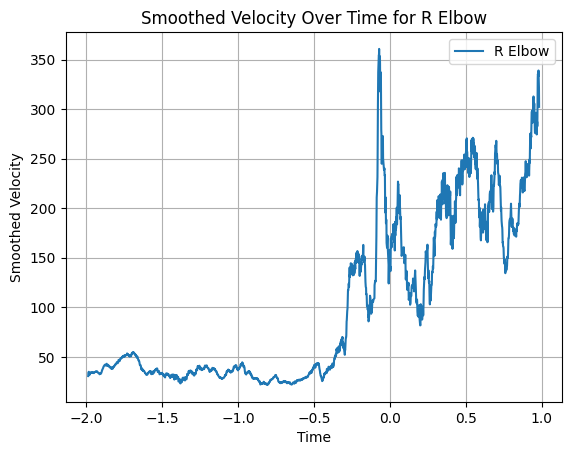

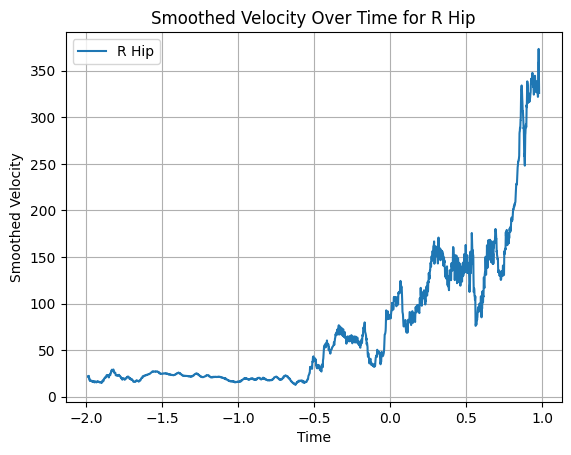

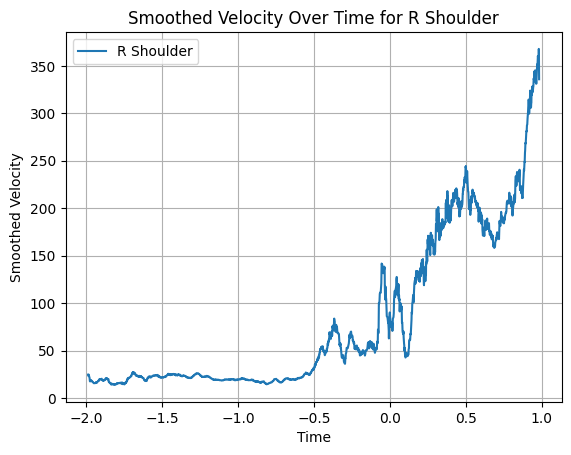

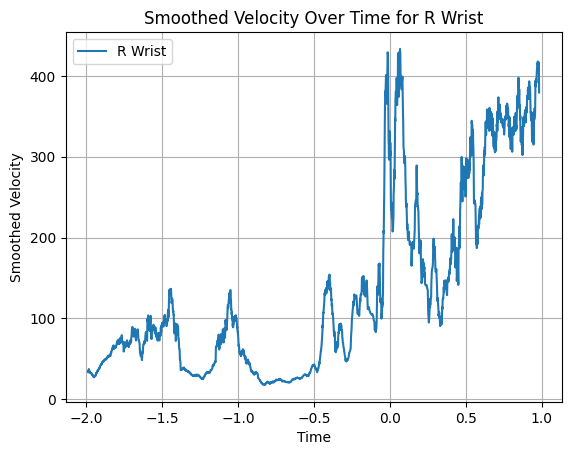

In [22]:
window_size = 20  # Adjust the window size for smoothing as needed

for joint_type in joint_types:
    plt.figure()  # Create a new figure for each joint
    joint_data = velo_df[velo_df['joint_type_id'] == joint_type].sort_values(by='time')
    joint_data['smoothed_velocity'] = moving_average(joint_data['velocity'], window_size)
    plt.plot(joint_data['time'], joint_data['smoothed_velocity'], label=joint_names.get(joint_type, f'Joint {joint_type}'))
    plt.xlabel('Time')
    plt.ylabel('Smoothed Velocity')
    plt.title(f'Smoothed Velocity Over Time for {joint_names.get(joint_type, f"Joint {joint_type}")}')
    plt.legend()
    plt.grid(True)
    plt.show()

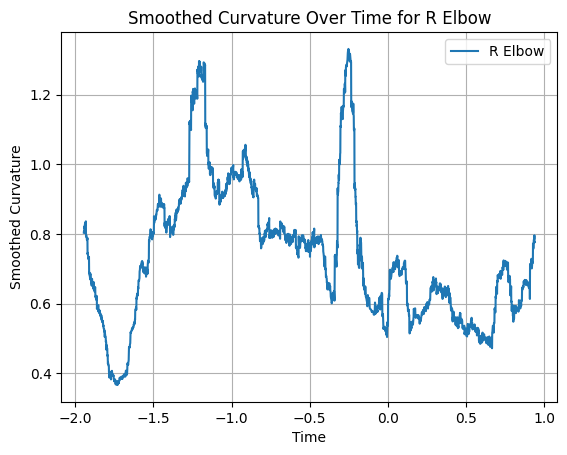

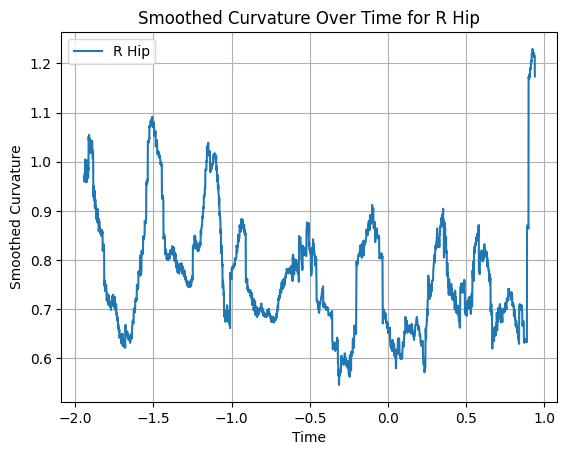

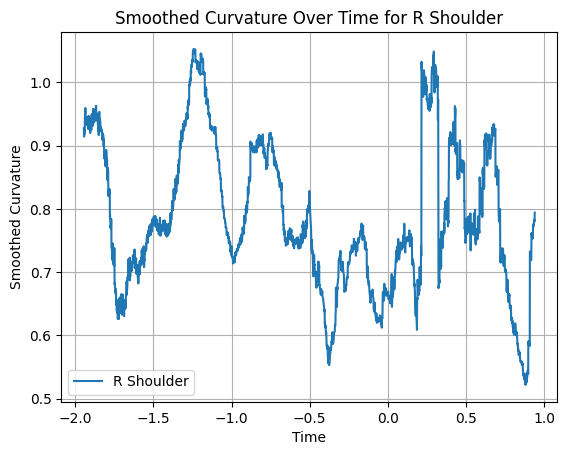

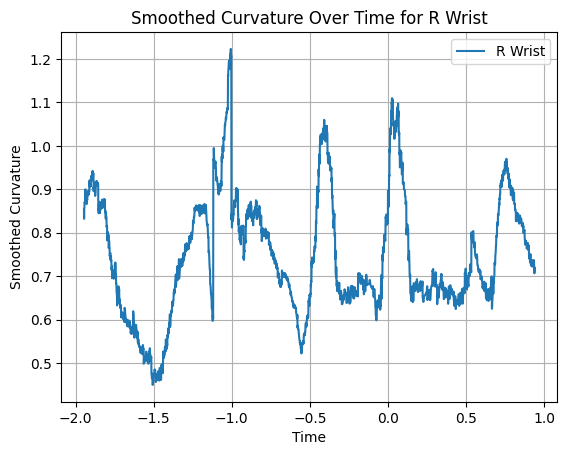

In [23]:
window_size = 100

for joint_type in joint_types:
    plt.figure()  # Create a new figure for each joint
    joint_data = velo_df[velo_df['joint_type_id'] == joint_type].sort_values(by='time')
    joint_data['smoothed_curvature'] = moving_average(joint_data['curvature'], window_size)
    plt.plot(joint_data['time'], joint_data['smoothed_curvature'], label=joint_names.get(joint_type, f'Joint {joint_type}'))
    plt.xlabel('Time')
    plt.ylabel('Smoothed Curvature')
    plt.title(f'Smoothed Curvature Over Time for {joint_names.get(joint_type, f"Joint {joint_type}")}')
    plt.legend()
    plt.grid(True)
    plt.show()

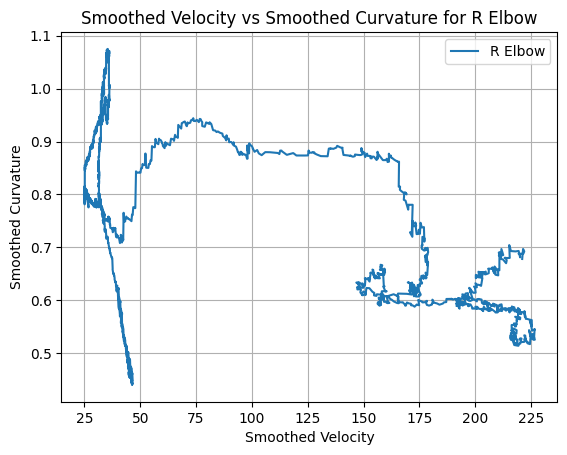

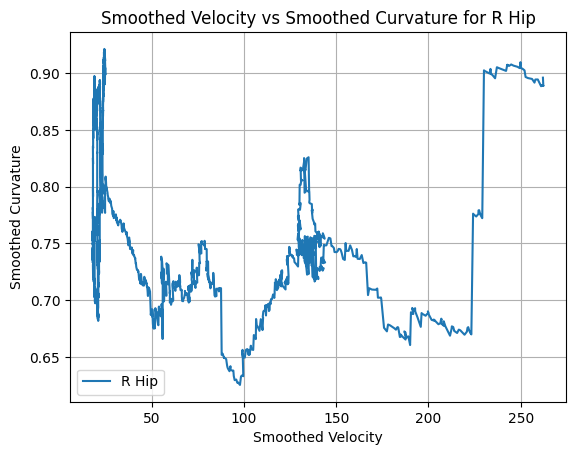

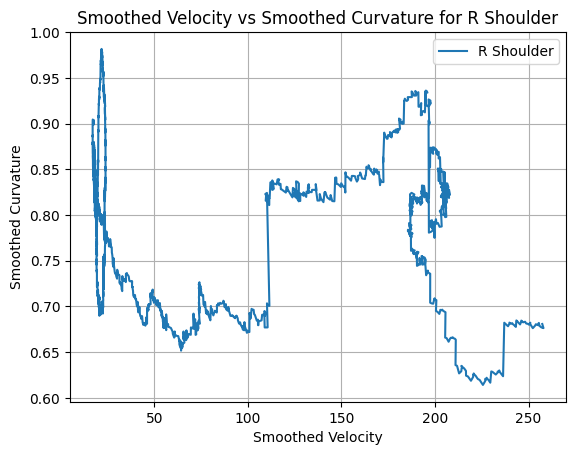

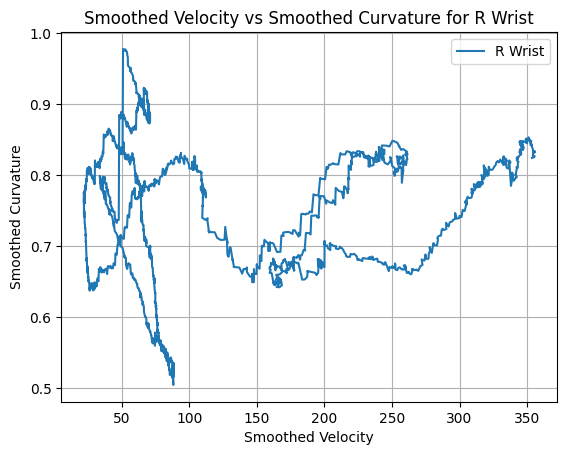

In [24]:
window_size = 250  # Adjust the window size for smoothing as needed
for joint_type in joint_types:
    plt.figure()  # Create a new figure for each joint
    joint_data = velo_df[velo_df['joint_type_id'] == joint_type].sort_values(by='time')
    joint_data['smoothed_curvature'] = moving_average(joint_data['curvature'], window_size)
    joint_data['smoothed_velocity'] = moving_average(joint_data['velocity'], window_size)
    plt.plot(joint_data['smoothed_velocity'], joint_data['smoothed_curvature'], label=joint_names.get(joint_type, f'Joint {joint_type}'))
    plt.xlabel('Smoothed Velocity')
    plt.ylabel('Smoothed Curvature')
    plt.title(f'Smoothed Velocity vs Smoothed Curvature for {joint_names.get(joint_type, f"Joint {joint_type}")}')
    plt.legend()
    plt.grid(True)
    plt.show()


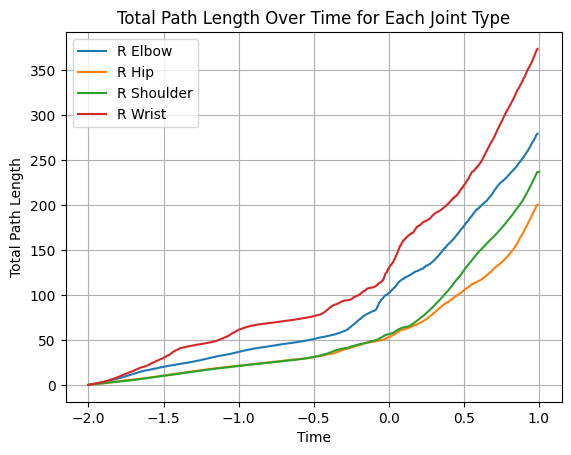

In [25]:
# Function to calculate the cumulative distance traveled by a joint
def calculate_cumulative_distance(df):
    df['distance'] = np.sqrt(df['x'].diff()**2 + df['y'].diff()**2 + df['z'].diff()**2)
    df['cumulative_distance'] = df['distance'].cumsum()
    return df

# Calculate the cumulative distance for each joint type and plot
for joint_type in joint_types:
    joint_data = velo_df[velo_df['joint_type_id'] == joint_type].sort_values(by='time')
    joint_data = calculate_cumulative_distance(joint_data)
    plt.plot(joint_data['time'], joint_data['cumulative_distance'], label=joint_names.get(joint_type, f'Joint {joint_type}'))
    
plt.xlabel('Time')
plt.ylabel('Total Path Length')
plt.title('Total Path Length Over Time for Each Joint Type')
plt.legend()
plt.grid(True)
plt.show()
